## Skin Cancer Detection
#### Random Forest classifier, Logistic Regression, Decision Tree, Naive Bayes, ResNet50, VGG16

### Import required libraries

In [1]:
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
# from tensorflow.python.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.applications.resnet50 import ResNet50,preprocess_input
from keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import RMSprop
from sklearn.metrics import accuracy_score,confusion_matrix

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from glob import glob
import seaborn as sns
from PIL import Image

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import ReduceLROnPlateau,EarlyStopping,ModelCheckpoint
from tensorflow.keras.applications import Xception
from tensorflow.keras.applications.vgg16 import VGG16

### Data preprocessing

In [2]:
print(os.listdir('archive/'))

['data', 'resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5', 'test', 'train']


In [3]:
benign_train = 'archive/train/benign'
malignant_train = 'archive/train/malignant'

benign_test = 'archive/test/benign'
malignant_test = 'archive/test/malignant'

read = lambda imname: np.asarray(Image.open(imname).convert("RGB"))

# Load in training pictures 
X_benign_train = np.array([read(os.path.join(benign_train, filename)) for filename in os.listdir(benign_train)], dtype='uint8')
X_malignant_train = np.array([read(os.path.join(malignant_train, filename)) for filename in os.listdir(malignant_train)], dtype='uint8')

# Load in testing pictures
X_benign_test = np.array([read(os.path.join(benign_test, filename)) for filename in os.listdir(benign_test)], dtype='uint8')
X_malignant_test = np.array([read(os.path.join(malignant_test, filename)) for filename in os.listdir(malignant_test)], dtype='uint8')

# Create labels
y_benign_train = np.zeros(X_benign_train.shape[0])
y_malignant_train = np.ones(X_malignant_train.shape[0])

y_benign_test = np.zeros(X_benign_test.shape[0])
y_malignant_test = np.ones(X_malignant_test.shape[0])

          
# Merge data 
X_train = np.concatenate((X_benign_train, X_malignant_train), axis = 0)
y_train = np.concatenate((y_benign_train, y_malignant_train), axis = 0)

X_test = np.concatenate((X_benign_test, X_malignant_test), axis = 0)
y_test = np.concatenate((y_benign_test, y_malignant_test), axis = 0)

# Shuffle data
s = np.arange(X_train.shape[0])
np.random.shuffle(s)
X_train = X_train[s]
y_train = y_train[s]

s = np.arange(X_test.shape[0])
np.random.shuffle(s)
X_test = X_test[s]
y_test = y_test[s]

### Data analysis

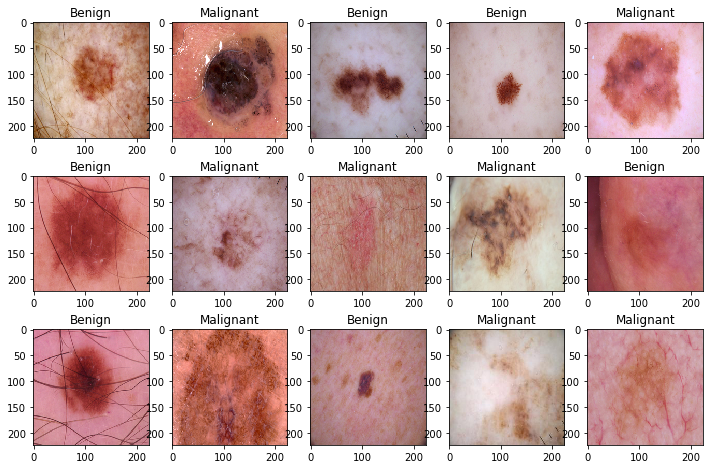

In [4]:
# Display first 15 images of moles, and how they are classified

fig=plt.figure(figsize=(12, 8))
for i in range(1, 16):
    ax = fig.add_subplot(3, 5, i)
    if y_train[i] == 0:
        ax.title.set_text('Benign')
    else:
        ax.title.set_text('Malignant')
    plt.imshow(X_train[i], interpolation='nearest')
plt.show()

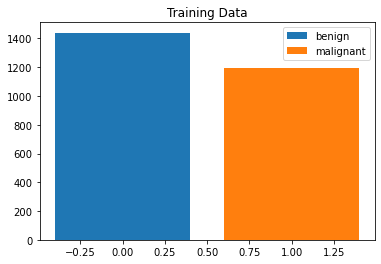

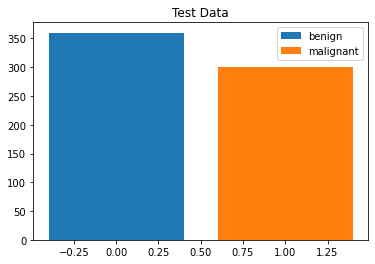

In [5]:
# Display the distribution of dataset
plt.bar(0, y_train[np.where(y_train == 0)].shape[0], label = 'benign')
plt.bar(1, y_train[np.where(y_train == 1)].shape[0], label = 'malignant')
plt.legend()
plt.title("Training Data")
plt.show()

plt.bar(0, y_test[np.where(y_test == 0)].shape[0], label = 'benign')
plt.bar(1, y_test[np.where(y_test == 1)].shape[0], label = 'malignant')
plt.legend()
plt.title("Test Data")
plt.show()

In [6]:
X_train = X_train/255.
X_test = X_test/255.

In [7]:
# Image data generation
image_width, image_height = 224,224

train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=20,
      shear_range=0.2,
      zoom_range=0.2,
      width_shift_range=0.3,
      height_shift_range=0.3,
      horizontal_flip=True,
      fill_mode='nearest')

test_datagen = ImageDataGenerator(rescale = 1./255.)

train_generator = train_datagen.flow_from_directory(
                    "archive/train",
                    batch_size=128,
                    class_mode='binary',
                    shuffle=True,
                    target_size=(image_width, image_height)
)     

test_generator =  test_datagen.flow_from_directory(
                    "archive/test",
                    batch_size=128,
                    class_mode='binary',
                    shuffle=True,
                    target_size=(image_width, image_height)
)

Found 2637 images belonging to 2 classes.
Found 660 images belonging to 2 classes.


## Model training

In [8]:
# Defining Lists to Store in the Results and Names of Algorithms
Algorithm = []
Accuracy = []

### 1. Random Forest Classifier

In [9]:
model1 = RandomForestClassifier(n_estimators = 100, random_state = 0)
model1.fit(X_train.reshape(X_train.shape[0],-1), y_train)
y_pred1 = model1.predict(X_test.reshape(X_test.shape[0],-1))

Algorithm.append('Random Forest classifier')
print(confusion_matrix(y_test,y_pred1))
Accuracy.append(accuracy_score(y_test, y_pred1)*100)
print(Algorithm[-1] +  ': ', Accuracy[-1])

[[284  76]
 [ 34 266]]
Random Forest classifier:  83.33333333333334


Model Prediction 

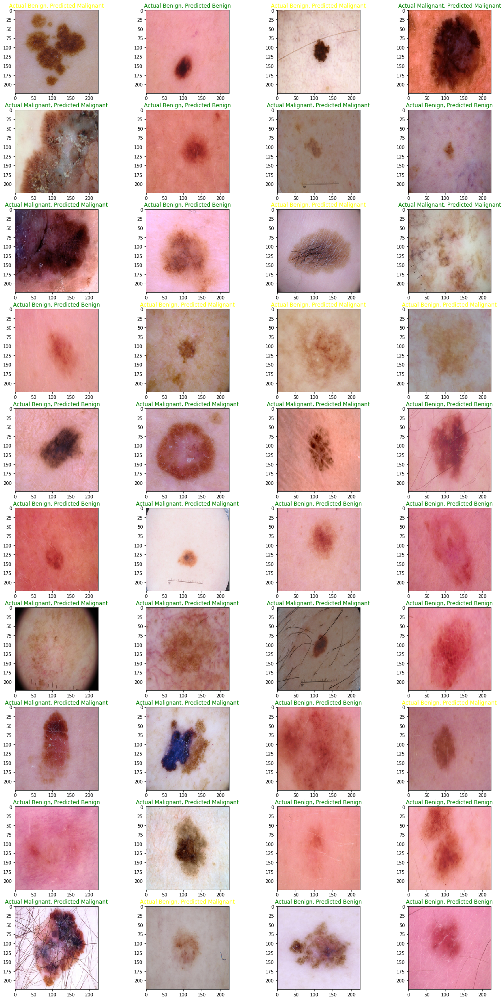

In [10]:
# shuffling data
s1 = np.arange(X_test.shape[0])
np.random.shuffle(s1)
X_test = X_test[s1]
y_test = y_test[s1]
y_pred = y_pred1[s1]

# plotting
fig = plt.figure(figsize=(20,40))
columns = 4
rows = 10

for i in range(1, columns*rows+1):
    ax = fig.add_subplot(rows, columns, i)
    if y_test[i] == 0:
        if y_pred[i] == 0:
            ax.set_title('Actual Benign, Predicted Benign', color='green')
        else:
            ax.set_title('Actual Benign, Predicted Malignant', color='yellow')
    else:
        if y_pred[i] == 1:
            ax.set_title('Actual Malignant, Predicted Malignant', color='green')
        else:
            ax.set_title('Actual Malignant, Predicted Benign', color='red')   
    plt.imshow(X_test[i], interpolation='nearest')
plt.show()


### 2. Logistic Regression Classifier

In [11]:
model2 = LogisticRegression(penalty='l2',solver='newton-cg',max_iter=200)
model2.fit(X_train.reshape(X_train.shape[0],-1), y_train)
y_pred2 = model2.predict(X_test.reshape(X_test.shape[0],-1))

Algorithm.append('Logistic Regression')
print(confusion_matrix(y_test,y_pred2))
Accuracy.append(accuracy_score(y_test, y_pred2)*100)
print(Algorithm[-1] +  ': ', Accuracy[-1])

[[297  63]
 [ 78 222]]
Logistic Regression:  78.63636363636364


Model Prediction 

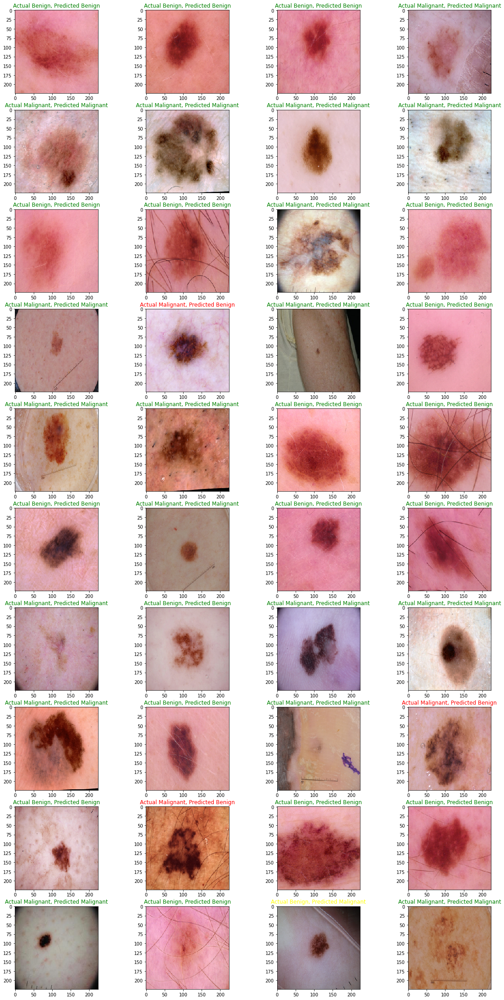

In [12]:
# shuffling data
s2 = np.arange(X_test.shape[0])
np.random.shuffle(s2)
X_test = X_test[s2]
y_test = y_test[s2]
y_pred = y_pred2[s2]

# plotting
fig = plt.figure(figsize=(20,40))
columns = 4
rows = 10

for i in range(1, columns*rows+1):
    ax = fig.add_subplot(rows, columns, i)
    if y_test[i] == 0:
        if y_pred[i] == 0:
            ax.set_title('Actual Benign, Predicted Benign', color='green')
        else:
            ax.set_title('Actual Benign, Predicted Malignant', color='yellow')
    else:
        if y_pred[i] == 1:
            ax.set_title('Actual Malignant, Predicted Malignant', color='green')
        else:
            ax.set_title('Actual Malignant, Predicted Benign', color='red')   
    plt.imshow(X_test[i], interpolation='nearest')
plt.show()


### 3. Decision Tree Classifier

In [35]:
model3 = DecisionTreeClassifier(criterion = 'entropy', random_state = 0)
model3.fit(X_train.reshape(X_train.shape[0],-1), y_train)
y_pred3 = model3.predict(X_test.reshape(X_test.shape[0],-1))

Algorithm.append('Decision Tree')
print(confusion_matrix(y_test,y_pred3))
Accuracy.append(accuracy_score(y_test, y_pred3)*100)
print(Algorithm[-1] +  ': ', Accuracy[-1])

[[282  78]
 [ 75 225]]
Decision Tree:  76.81818181818181


Model Prediction

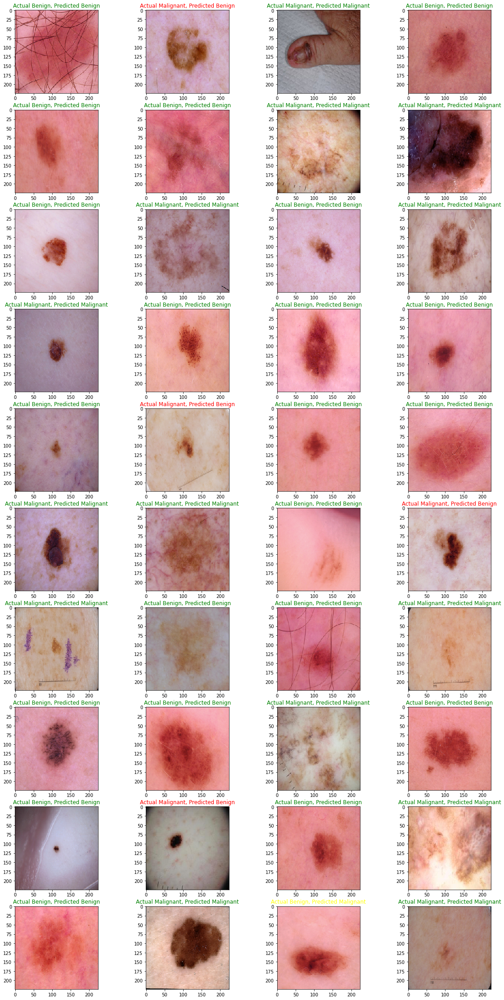

In [14]:
# shuffling data
s3 = np.arange(X_test.shape[0])
np.random.shuffle(s3)
X_test = X_test[s3]
y_test = y_test[s3]
y_pred = y_pred3[s3]

# plotting
fig = plt.figure(figsize=(20,40))
columns = 4
rows = 10

for i in range(1, columns*rows+1):
    ax = fig.add_subplot(rows, columns, i)
    if y_test[i] == 0:
        if y_pred[i] == 0:
            ax.set_title('Actual Benign, Predicted Benign', color='green')
        else:
            ax.set_title('Actual Benign, Predicted Malignant', color='yellow')
    else:
        if y_pred[i] == 1:
            ax.set_title('Actual Malignant, Predicted Malignant', color='green')
        else:
            ax.set_title('Actual Malignant, Predicted Benign', color='red')   
    plt.imshow(X_test[i], interpolation='nearest')
plt.show()

### 4.Naive Bayes Classifier

In [15]:
model4 = GaussianNB()
model4.fit(X_train.reshape(X_train.shape[0],-1), y_train)
y_pred4 = model4.predict(X_test.reshape(X_test.shape[0],-1))

Algorithm.append('Naive Bayes')
print(confusion_matrix(y_test,y_pred4))
Accuracy.append(accuracy_score(y_test, y_pred4)*100)
print(Algorithm[-1] +  ': ', Accuracy[-1])

[[264  96]
 [101 199]]
Naive Bayes:  70.15151515151516


Model Prediction

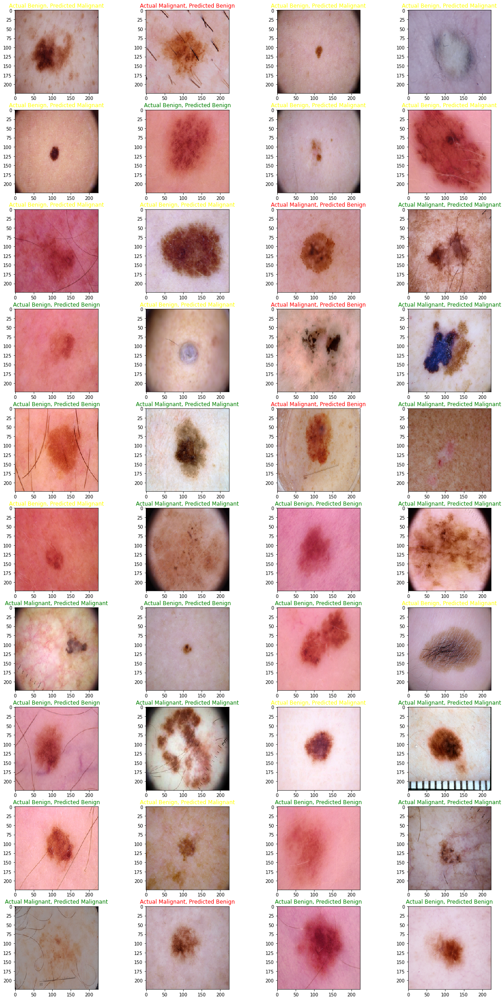

In [16]:
# shuffling data
s4 = np.arange(X_test.shape[0])
np.random.shuffle(s4)
X_test = X_test[s4]
y_test = y_test[s4]
y_pred = y_pred4[s4]

# plotting
fig = plt.figure(figsize=(20,40))
columns = 4
rows = 10

for i in range(1, columns*rows+1):
    ax = fig.add_subplot(rows, columns, i)
    if y_test[i] == 0:
        if y_pred[i] == 0:
            ax.set_title('Actual Benign, Predicted Benign', color='green')
        else:
            ax.set_title('Actual Benign, Predicted Malignant', color='yellow')
    else:
        if y_pred[i] == 1:
            ax.set_title('Actual Malignant, Predicted Malignant', color='green')
        else:
            ax.set_title('Actual Malignant, Predicted Benign', color='red')   
    plt.imshow(X_test[i], interpolation='nearest')
plt.show()


### Support vector machine classifier

In [17]:
# model = SVC()
# model.fit(X_train.reshape(X_train.shape[0],-1), y_train)

# y_pred = model.predict(X_test.reshape(X_test.shape[0],-1))

# Algorithm.append('Support vector machine classifier')
# Accuracy.append(accuracy_score(y_test, y_pred)*100)

# print(Algorithm[-1] +  ': ', Accuracy[-1])

### 5. Resnet-50

In [18]:
# model5 = Sequential()
# model5.add(ResNet50(include_top=False,input_tensor=None,input_shape=(224,224,3),pooling='avg',classes=2))
# model5.add(Flatten())
# model5.add(Dense(2048, activation='relu'))
# model5.add(Dropout(0.5))
# model5.add(Dense(1024, activation='relu'))
# model5.add(Dropout(0.3))
# model5.add(Dense(1, activation='sigmoid'))

# model5.layers[0].trainable = False
model5 = Sequential()

model5.add(ResNet50(
    include_top=False,
    pooling='avg',
    weights='imagenet'
    ))

    model5.add(Flatten())
model5.add(Dense(5500, activation='relu'))
model5.add(Dropout(0.2))
model5.add(Dense(1, activation='sigmoid'))

model5.layers[0].trainable = False 

# Compile model
model5.compile(optimizer=RMSprop(lr=0.0001),loss='binary_crossentropy',metrics=['accuracy'])

#Learning rate decay with ReduceLROnPlateau
reduce_lr= ReduceLROnPlateau(monitor='val_accuracy',patience=2,verbose=1,factor=0.4)

C:\ProgramData\Anaconda3\lib\site-packages\keras\optimizers\optimizer_v2\rmsprop.py:140: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [19]:
# Train model
History5 = model5.fit(train_generator,
                    epochs = 50,
                    validation_data = test_generator,
                    validation_steps = 5,
                    verbose = 1, callbacks=[reduce_lr])

Epoch 1/50
21/21 [==============================] - 107s 5s/step - loss: 0.7464 - accuracy: 0.5028 - val_loss: 0.7104 - val_accuracy: 0.4531 - lr: 1.0000e-04
Epoch 2/50
21/21 [==============================] - 106s 5s/step - loss: 0.7025 - accuracy: 0.5476 - val_loss: 0.8726 - val_accuracy: 0.5422 - lr: 1.0000e-04
Epoch 3/50
21/21 [==============================] - 106s 5s/step - loss: 0.7293 - accuracy: 0.5233 - val_loss: 0.6886 - val_accuracy: 0.4578 - lr: 1.0000e-04
Epoch 4/50
21/21 [==============================] - 106s 5s/step - loss: 0.7084 - accuracy: 0.5271 - val_loss: 0.7089 - val_accuracy: 0.5500 - lr: 1.0000e-04
Epoch 5/50
21/21 [==============================] - 105s 5s/step - loss: 0.6973 - accuracy: 0.5582 - val_loss: 0.7141 - val_accuracy: 0.4547 - lr: 1.0000e-04
Epoch 6/50
21/21 [==============================] - ETA: 0s - loss: 0.7065 - accuracy: 0.5355
Epoch 6: ReduceLROnPlateau reducing learning rate to 3.9999998989515007e-05.
21/21 [==============================] 

In [21]:
y_pred5 = np.argmax(model5.predict(X_test), axis=-1)

21/21 [==============================] - 19s 854ms/step


In [22]:
score5 = model5.evaluate(test_generator, verbose=1, steps=5)

Algorithm.append('ResNet50')
Accuracy.append(score5[1] * 100)
print(confusion_matrix(y_test,y_pred5))
print(Algorithm[-1] +  ': ', Accuracy[-1])

5/5 [==============================] - 17s 3s/step - loss: 0.6391 - accuracy: 0.6781
[[360   0]
 [300   0]]
ResNet50:  67.81250238418579


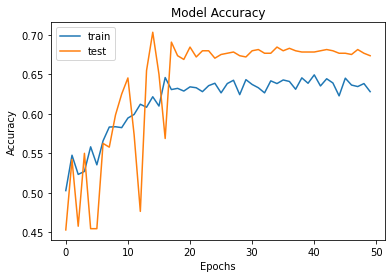

In [23]:
plt.plot(History5.history['accuracy'])
plt.plot(History5.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'test'])
plt.show()

Model Prediction

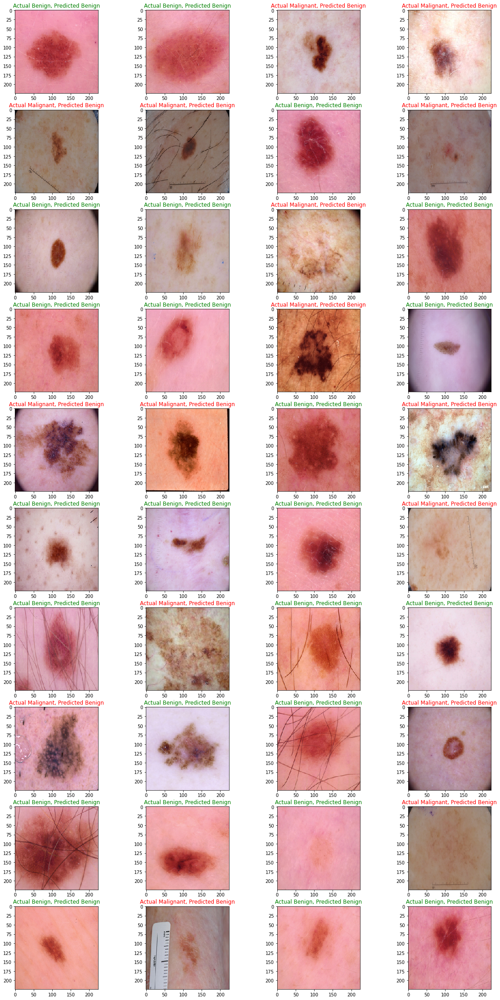

In [24]:
# shuffling data
s5 = np.arange(X_test.shape[0])
np.random.shuffle(s5)
X_test = X_test[s5]
y_test = y_test[s5]
y_pred = y_pred5[s5]

# plotting
fig = plt.figure(figsize=(20,40))
columns = 4
rows = 10

for i in range(1, columns*rows+1):
    ax = fig.add_subplot(rows, columns, i)
    if y_test[i] == 0:
        if y_pred[i] == 0:
            ax.set_title('Actual Benign, Predicted Benign', color='green')
        else:
            ax.set_title('Actual Benign, Predicted Malignant', color='yellow')
    else:
        if y_pred[i] == 1:
            ax.set_title('Actual Malignant, Predicted Malignant', color='green')
        else:
            ax.set_title('Actual Malignant, Predicted Benign', color='red')   
    plt.imshow(X_test[i], interpolation='nearest')
plt.show()


### 6. Very deep convolutional network [VGG16]

In [25]:
vvg = VGG16(input_shape=(224,224, 3), include_top = False, weights = 'imagenet')
for layers in (vvg.layers):
    layers.trainable = False

In [26]:
model6 = Sequential()
model6.add(vvg)

# Add new layers
model6.add(Flatten())
model6.add(Dense(4096 , activation='relu'))
model6.add(Dropout(0.5))
model6.add(Dense(4096 , activation='relu'))
model6.add(Dropout(0.3))
model6.add(Dense(4096, activation='relu'))
model6.add(Dropout(0.4))
model6.add(Dense(1, activation='sigmoid'))

model6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_1 (Flatten)         (None, 25088)             0         
                                                                 
 dense_2 (Dense)             (None, 4096)              102764544 
                                                                 
 dropout_1 (Dropout)         (None, 4096)              0         
                                                                 
 dense_3 (Dense)             (None, 4096)              16781312  
                                                                 
 dropout_2 (Dropout)         (None, 4096)              0         
                                                                 
 dense_4 (Dense)             (None, 4096)             

In [27]:
lr = 1e-6
model6.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=lr), metrics=['accuracy'])
mcp = ModelCheckpoint('modelVVG16.h5', verbose=1)
# es = EarlyStopping(patience=2,verbose=1)

History6 = model6.fit(train_generator,
                    epochs = 50,
                    validation_data = test_generator,
                    validation_steps = 5,
                    verbose = 1,
                    callbacks = [mcp])

Epoch 1/50
21/21 [==============================] - ETA: 0s - loss: 0.7231 - accuracy: 0.5207
Epoch 1: saving model to modelVVG16.h5
21/21 [==============================] - 195s 9s/step - loss: 0.7231 - accuracy: 0.5207 - val_loss: 0.6772 - val_accuracy: 0.5406
Epoch 2/50
21/21 [==============================] - ETA: 0s - loss: 0.7035 - accuracy: 0.5415
Epoch 2: saving model to modelVVG16.h5
21/21 [==============================] - 209s 10s/step - loss: 0.7035 - accuracy: 0.5415 - val_loss: 0.6563 - val_accuracy: 0.5562
Epoch 3/50
21/21 [==============================] - ETA: 0s - loss: 0.7002 - accuracy: 0.5457
Epoch 3: saving model to modelVVG16.h5
21/21 [==============================] - 203s 10s/step - loss: 0.7002 - accuracy: 0.5457 - val_loss: 0.6418 - val_accuracy: 0.5797
Epoch 4/50
21/21 [==============================] - ETA: 0s - loss: 0.6960 - accuracy: 0.5597
Epoch 4: saving model to modelVVG16.h5
21/21 [==============================] - 204s 10s/step - loss: 0.6960 - accu

In [28]:
y_pred6 = np.argmax(model6.predict(X_test), axis=-1)

21/21 [==============================] - 43s 2s/step


In [29]:
score6 = model6.evaluate(test_generator, verbose=1, steps=5)

Algorithm.append('VGG16')
Accuracy.append(score6[1] * 100)
print(confusion_matrix(y_test,y_pred6))
print(Algorithm[-1] +  ': ', Accuracy[-1])

5/5 [==============================] - 41s 8s/step - loss: 0.3896 - accuracy: 0.8234
[[360   0]
 [300   0]]
VGG16:  82.3437511920929


Text(0.5, 1.0, 'Training and validation loss')

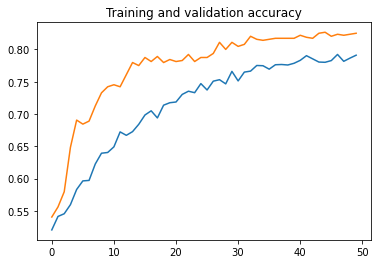

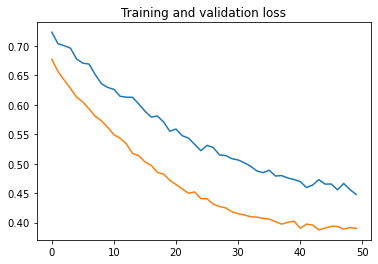

In [30]:
accuracy      = History6.history['accuracy']
val_accuracy  = History6.history['val_accuracy']
loss     = History6.history['loss']
val_loss = History6.history['val_loss']

epochs   = range(len(accuracy))

plt.plot(epochs, accuracy)
plt.plot(epochs, val_accuracy)
plt.title('Training and validation accuracy')
plt.figure()

# Plot training and validation loss per epoch
plt.plot(epochs, loss)
plt.plot(epochs, val_loss)
plt.title('Training and validation loss')

Model Prediction

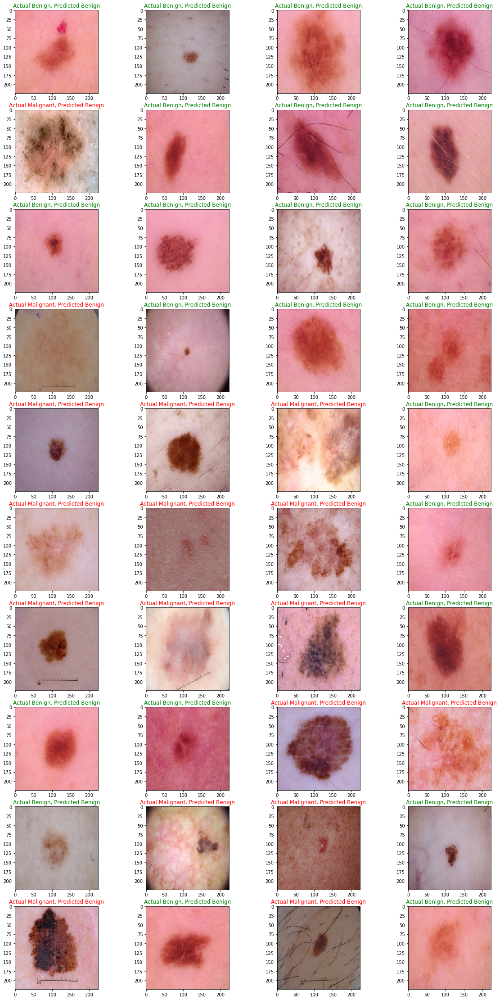

In [33]:
# shuffling data
s6 = np.arange(X_test.shape[0])
np.random.shuffle(s6)
X_test = X_test[s6]
y_test = y_test[s6]
y_pred = y_pred6[s6]

# plotting
fig = plt.figure(figsize=(20,40))
columns = 4
rows = 10

for i in range(1, columns*rows+1):
    ax = fig.add_subplot(rows, columns, i)
    if y_test[i] == 0:
        if y_pred[i] == 0:
            ax.set_title('Actual Benign, Predicted Benign', color='green')
        else:
            ax.set_title('Actual Benign, Predicted Malignant', color='yellow')
    else:
        if y_pred[i] == 1:
            ax.set_title('Actual Malignant, Predicted Malignant', color='green')
        else:
            ax.set_title('Actual Malignant, Predicted Benign', color='red')   
    plt.imshow(X_test[i], interpolation='nearest')
plt.show()


### Accuracy

In [32]:
# Algorithms
pd.DataFrame(list(zip(Algorithm, Accuracy)), columns = ['Algorithm', 'Accuracy'])

,Algorithm,Accuracy
0,Random Forest classifier,83.333333
1,Logistic Regression,78.636364
2,Decision Tree,76.818182
3,Naive Bayes,70.151515
4,ResNet50,67.812502
5,VGG16,82.343751
